In [1]:
file_path = "../data/raw/H_Kidney_Cancer_Chromium_Nuc_Iso_vs_SaltyEZ_vs_ComplexTissueDP_filtered_feature_bc_matrix.h5"

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata as ad
import muon as mu
import seaborn as sns

/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
mdata = mu.read_10x_h5(file_path)
mdata.var_names_make_unique()

/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Added `interval` annotation for features from ../data/raw/H_Kidney_Cancer_Chromium_Nuc_Iso_vs_SaltyEZ_vs_ComplexTissueDP_filtered_feature_bc_matrix.h5


/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1531: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("var", axis=0, join_common=join_common)
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:915: UserWarning: var_names are not unique. To make them unique, call `.var_names_make_unique`.
  warnings.warn(
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning

In [4]:
barcodes = mdata.obs.index

In [5]:
mdata_1 = mdata[barcodes.str.endswith("-1")].copy()
mdata_2 = mdata[barcodes.str.endswith("-2")].copy()

/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1531: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("var", axis=0, join_common=join_common)
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("obs", axis=1, join_common=join_common)
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1531: 

# Preprocessing of Batch 1

In [6]:
rna = mdata_1.mod['rna']
atac = mdata_1.mod['atac']

In [196]:
rna.var_names_make_unique()

In [197]:
rna.var['mt'] = rna.var_names.str.startswith('MT-')

In [198]:
sc.pp.calculate_qc_metrics(
    rna, qc_vars=['mt'], inplace=True, percent_top=[20],log1p=True
)

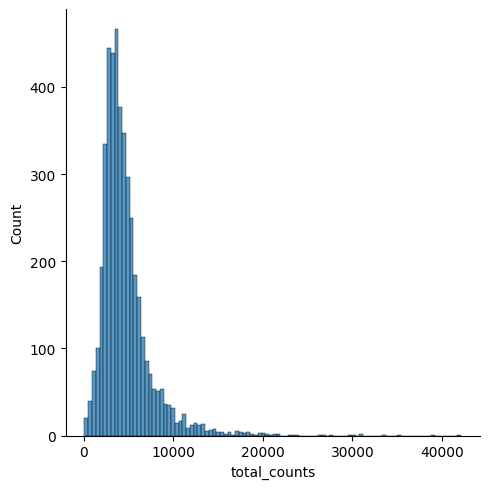

In [11]:
p1 = sns.displot(rna.obs["total_counts"], bins=100, kde=False)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


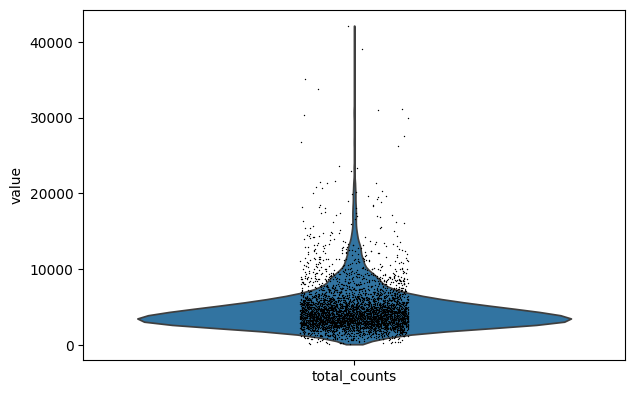

In [12]:
p8 = sc.pl.violin(rna, 'total_counts')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


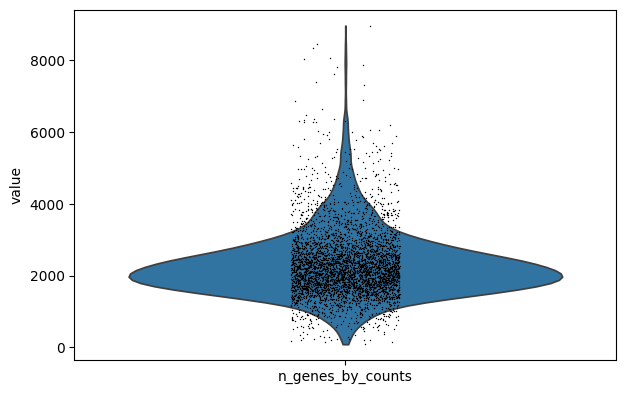

In [13]:
p5 = sc.pl.violin(rna, 'n_genes_by_counts')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


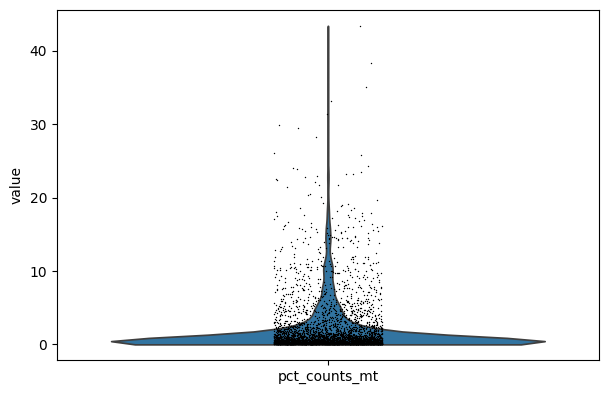

In [14]:
p2 = sc.pl.violin(rna, "pct_counts_mt")

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_utils.py:716: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]


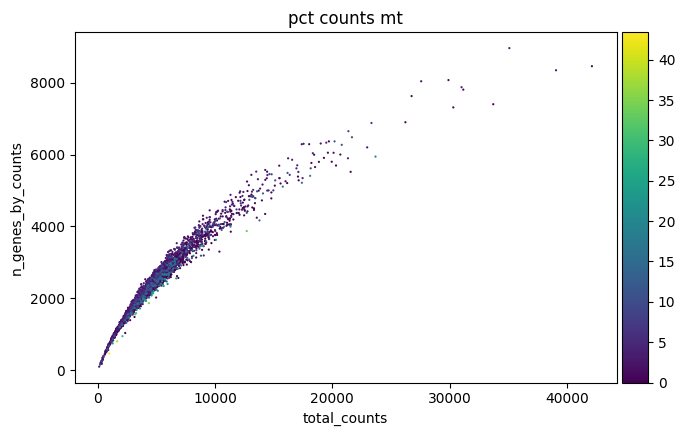

In [15]:
p3 = sc.pl.scatter(rna, "total_counts", "n_genes_by_counts", color="pct_counts_mt",size=10)

In [199]:
rna

AnnData object with n_obs × n_vars = 4453 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [200]:
rna = rna[rna.obs['total_counts'] >= 500, :]
rna = rna[rna.obs['total_counts'] <= 20000, :]

In [201]:
rna

View of AnnData object with n_obs × n_vars = 4410 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [202]:
sc.pp.filter_cells(rna, min_genes=500)
sc.pp.filter_cells(rna, max_genes=6000)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/preprocessing/_simple.py:139: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


In [203]:
rna

AnnData object with n_obs × n_vars = 4396 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [204]:
rna = rna[rna.obs['pct_counts_mt'] < 10, :]

In [205]:
rna

View of AnnData object with n_obs × n_vars = 4212 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/anndata/_core/anndata.py:1146: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


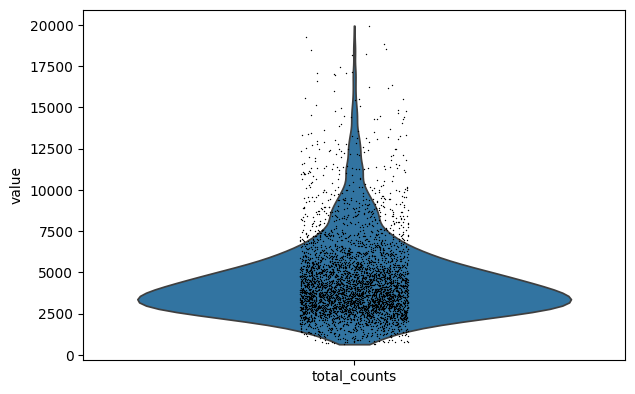

In [206]:
p8 = sc.pl.violin(rna, 'total_counts')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


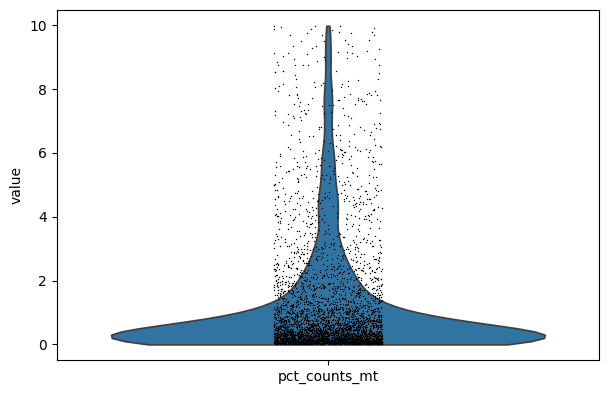

In [24]:
p2 = sc.pl.violin(rna, "pct_counts_mt")

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


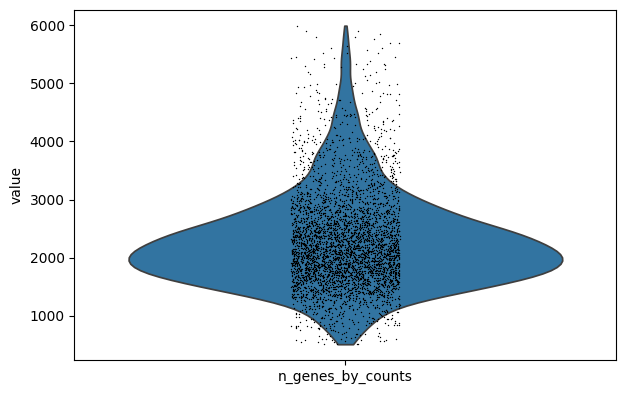

In [25]:
p5 = sc.pl.violin(rna, 'n_genes_by_counts')

In [207]:
sc.pp.normalize_total(rna)
sc.pp.log1p(rna)

In [208]:
sc.pp.highly_variable_genes(rna, n_top_genes=2000)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


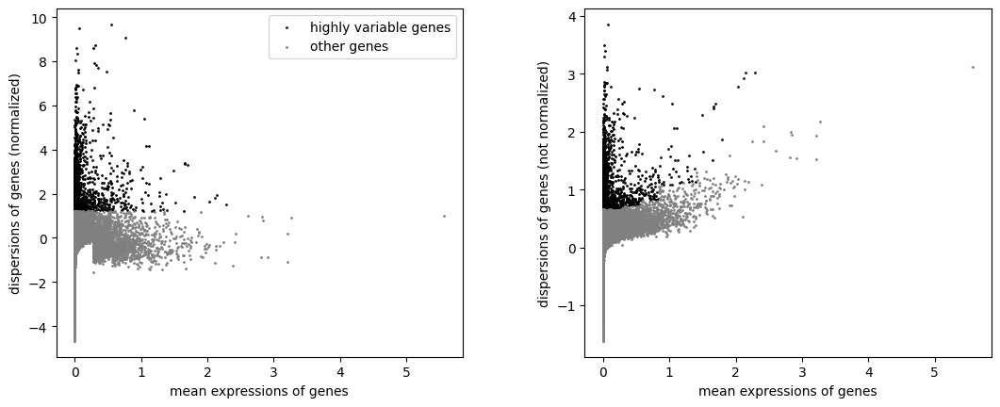

In [209]:
sc.pl.highly_variable_genes(rna)

In [29]:
#rna = rna[:, rna.var.highly_variable]

In [210]:
sc.pp.scale(rna, max_value=10)

In [211]:
sc.tl.pca(rna)

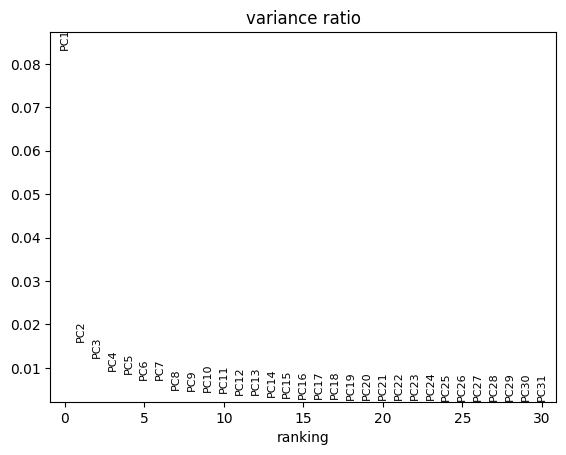

In [213]:
sc.pl.pca_variance_ratio(rna)

In [214]:
sc.pp.neighbors(rna)

In [215]:
sc.tl.umap(rna)

In [216]:
sc.tl.leiden(rna, resolution=0.8)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


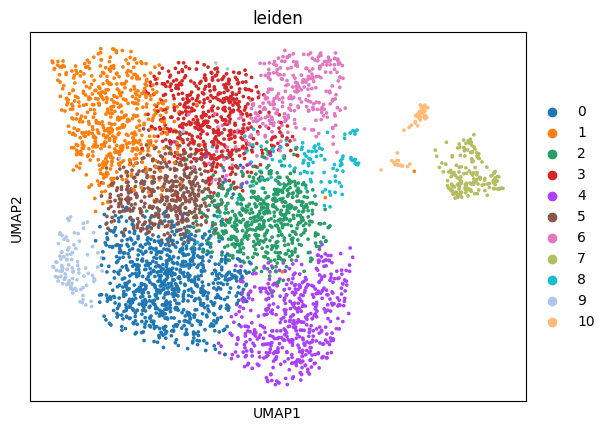

In [217]:
sc.pl.umap(rna, color='leiden')

In [7]:
from muon import atac as ac

In [8]:
sc.pp.calculate_qc_metrics(atac, percent_top=None, log1p=False, inplace=True)

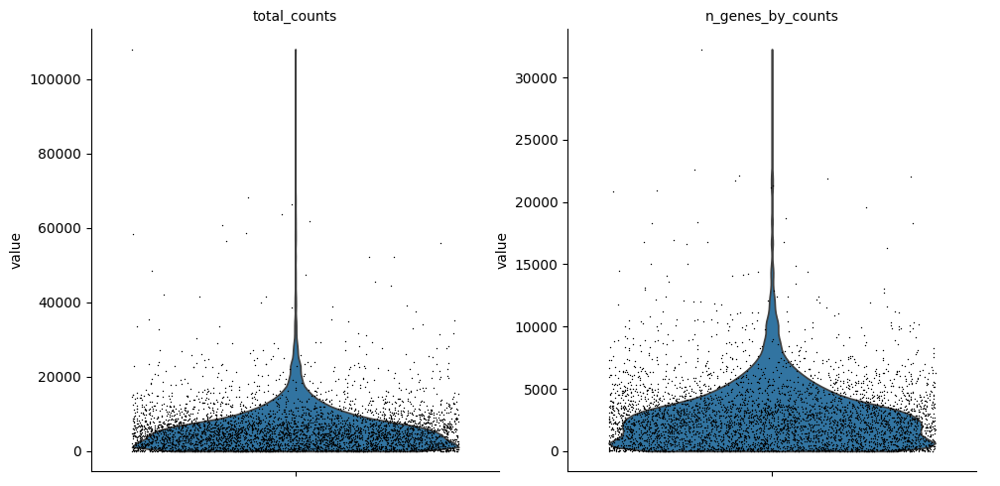

In [38]:
sc.pl.violin(atac, ['total_counts', 'n_genes_by_counts'], jitter=0.4, multi_panel=True)

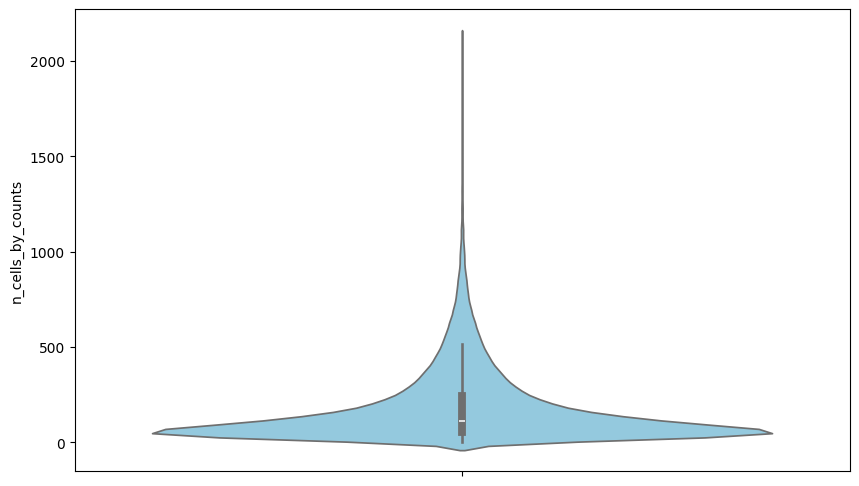

In [39]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10,6))
sns.violinplot(data=atac.var['n_cells_by_counts'],color='skyblue')
plt.show()

In [9]:
atac

AnnData object with n_obs × n_vars = 4453 × 67150
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [10]:
mu.pp.filter_var(atac, 'n_cells_by_counts', lambda x: x >= 20)
mu.pp.filter_var(atac, 'n_cells_by_counts', lambda x: x <= 1200)

In [11]:
atac

AnnData object with n_obs × n_vars = 4453 × 64000
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [12]:
mu.pp.filter_obs(atac, 'n_genes_by_counts', lambda x: (x >= 300) & (x <= 15000))

In [13]:
atac

AnnData object with n_obs × n_vars = 3868 × 64000
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [14]:
mu.pp.filter_obs(atac, 'total_counts', lambda x: (x >= 300) & (x <= 40000))

In [15]:
atac

AnnData object with n_obs × n_vars = 3868 × 64000
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

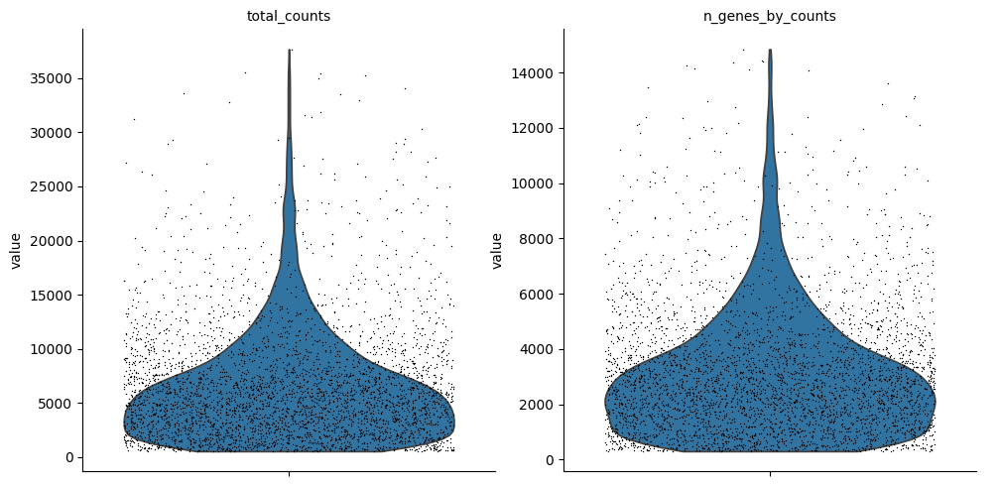

In [47]:
sc.pl.violin(atac, ['total_counts', 'n_genes_by_counts'], jitter=0.4, multi_panel=True)

In [16]:
atac.layers['counts'] = atac.X

In [17]:
sc.pp.normalize_per_cell(atac, counts_per_cell_after=1e4)
sc.pp.log1p(atac)

In [18]:
sc.pp.highly_variable_genes(atac, min_mean=0.05, max_mean=1.5, min_disp=.5)

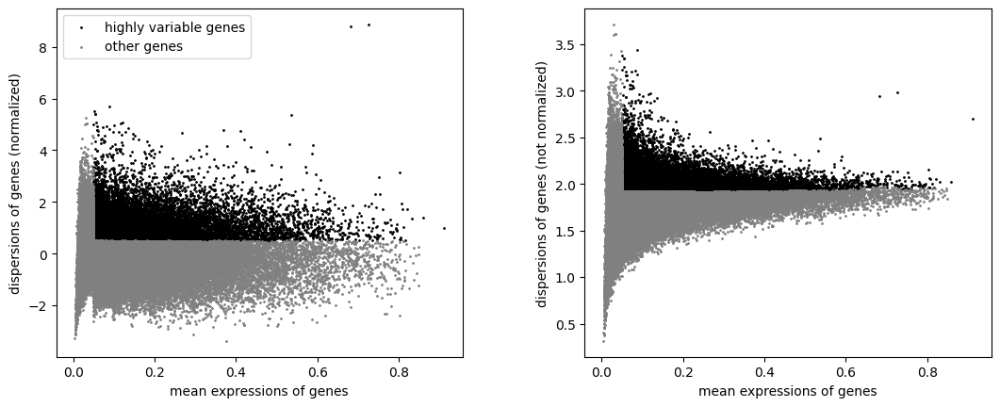

In [51]:
sc.pl.highly_variable_genes(atac)

In [19]:
np.sum(atac.var.highly_variable)

np.int64(13269)

In [20]:
atac.raw = atac

In [21]:
ac.tl.lsi(atac)

In [55]:
atac.obsm['X_lsi'] = atac.obsm['X_lsi'][:,1:]
atac.varm["LSI"] = atac.varm["LSI"][:,1:]
atac.uns["lsi"]["stdev"] = atac.uns["lsi"]["stdev"][1:]

In [56]:
sc.pp.neighbors(atac, use_rep="X_lsi", n_neighbors=10, n_pcs=30)

In [57]:
sc.pp.scale(atac)
sc.tl.pca(atac)

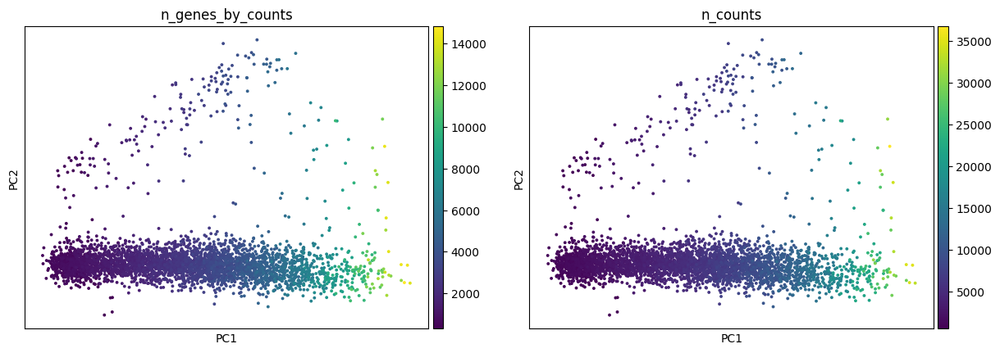

In [58]:
sc.pl.pca(atac, color=["n_genes_by_counts", "n_counts"])

In [59]:
sc.pp.neighbors(atac, n_neighbors=10, n_pcs=30)

In [60]:
sc.tl.leiden(atac, resolution=.5)

In [61]:
sc.tl.umap(atac, spread=1.5, min_dist=.5, random_state=20)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


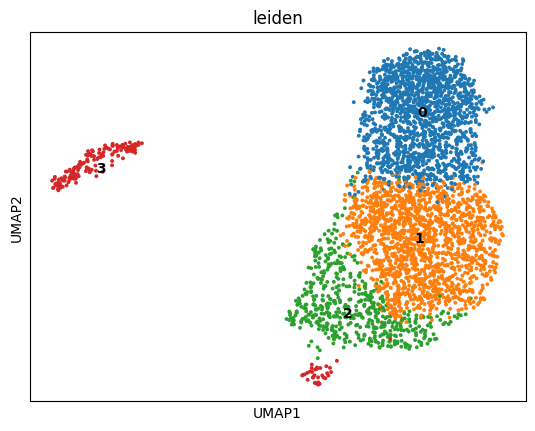

In [62]:
sc.pl.umap(atac, color="leiden", legend_loc="on data")

In [63]:
mdata_1.mod['rna'] = rna

In [22]:
mdata_1.mod['atac'] = atac

In [23]:
mdata_1 = mdata_1.copy()

/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1531: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("var", axis=0, join_common=join_common)
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("obs", axis=1, join_common=join_common)


In [66]:
mu.pp.intersect_obs(mdata_1)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("obs", axis=1, join_common=join_common)


## Create a tsv file for rna

In [67]:
barcodes = mdata_1.mod['rna'].obs.index
gene_ids = mdata_1.mod['rna'].var['gene_ids']

In [68]:
expression_matrix = mdata_1.mod['rna'].X
if not isinstance(expression_matrix, np.ndarray):
    expression_matrix = expression_matrix.toarray() 

In [69]:
data_1 = pd.DataFrame(
    {
        'barcode': np.repeat(barcodes, len(gene_ids)),
        'gene_id': np.tile(gene_ids, len(barcodes)),
        'expression_count': expression_matrix.flatten()
    }
)

In [70]:
data1 = data_1[data_1['expression_count'] != 0]

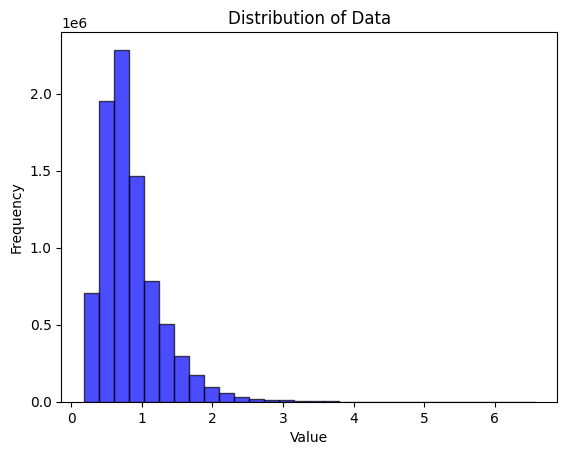

In [71]:
plt.hist(data1['expression_count'], bins=30, color='blue', alpha=0.7, edgecolor='black')
plt.title('Distribution of Data')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

In [72]:
median_expression = data1['expression_count'].median()

In [73]:
data_1['classification'] = data_1['expression_count'].apply(
    lambda x: 'high' if x > median_expression  
            else 'zero' if x == 0 
            else 'low'
)

In [74]:
classification_counts_median = data_1['classification'].value_counts()

In [75]:
classification_counts_median

classification
zero    126321180
low       4203674
high      4203427
Name: count, dtype: int64

In [76]:
data_1

,barcode,gene_id,expression_count,classification
0,AAACAGCCACAATACT-1,ENSG00000243485,0.0,zero
1,AAACAGCCACAATACT-1,ENSG00000237613,0.0,zero
2,AAACAGCCACAATACT-1,ENSG00000186092,0.0,zero
3,AAACAGCCACAATACT-1,ENSG00000238009,0.0,zero
4,AAACAGCCACAATACT-1,ENSG00000239945,0.0,zero
...,...,...,...,...
134728276,TTTGTTGGTGGCTTCC-1,ENSG00000277836,0.0,zero
134728277,TTTGTTGGTGGCTTCC-1,ENSG00000278633,0.0,zero
134728278,TTTGTTGGTGGCTTCC-1,ENSG00000276017,0.0,zero
134728279,TTTGTTGGTGGCTTCC-1,ENSG00000278817,0.0,zero


## Create a tsv file for atac

In [ ]:
barcodes = mdata_1.mod['atac'].obs.index
peak_region = mdata_1.mod['atac'].var['gene_ids']

(64000,)


In [29]:
open_matrix = mdata_1.mod['atac'].X
if not isinstance(open_matrix, np.ndarray):
    open_matrix = open_matrix.toarray()

In [35]:
open_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [36]:
import numpy as np

# Count nonzero elements
num_nonzero = np.count_nonzero(open_matrix)

# Count negative elements
num_negative = np.sum(open_matrix < 0)

print(f"Nonzero elements: {num_nonzero}")
print(f"Negative elements: {num_negative}")


Nonzero elements: 11633502
Negative elements: 0


In [33]:
data_1 = pd.DataFrame(
    {
        'barcode': np.repeat(barcodes, len(peak_region)),
        'peak region': np.tile(peak_region, len(barcodes)),
        'opennes': open_matrix.flatten()
    }
)

In [34]:
data_1.head()

,barcode,peak region,opennes
0,AAACAGCCACAATACT-1,chr1:9855-10676,0.0
1,AAACAGCCACAATACT-1,chr1:181027-181582,0.0
2,AAACAGCCACAATACT-1,chr1:629494-630387,0.0
3,AAACAGCCACAATACT-1,chr1:633523-634601,0.0
4,AAACAGCCACAATACT-1,chr1:778319-779215,0.0


In [37]:
data_1.to_csv("../data/splits/atac_batch1.tsv", sep='\t', index=False)


# Annotation Batch 1

In [218]:
sc.tl.rank_genes_groups(rna, 'leiden', method='t-test')


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes

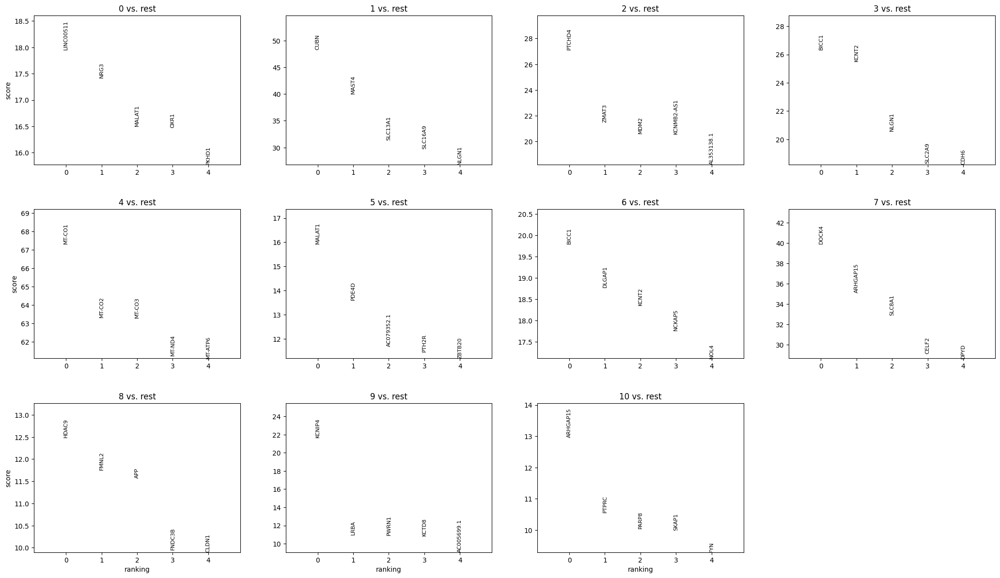

In [219]:
sc.pl.rank_genes_groups(rna, n_genes=5, sharey=False)

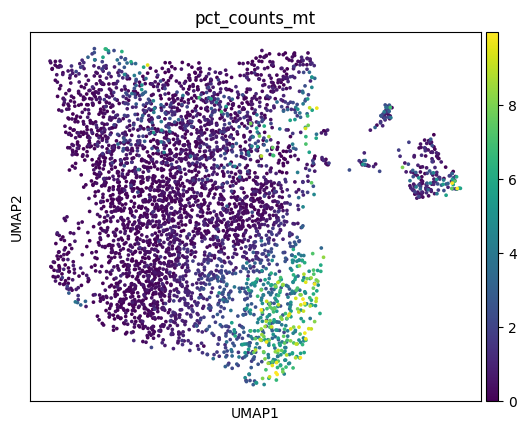

In [220]:
sc.pl.umap(rna, color='pct_counts_mt')

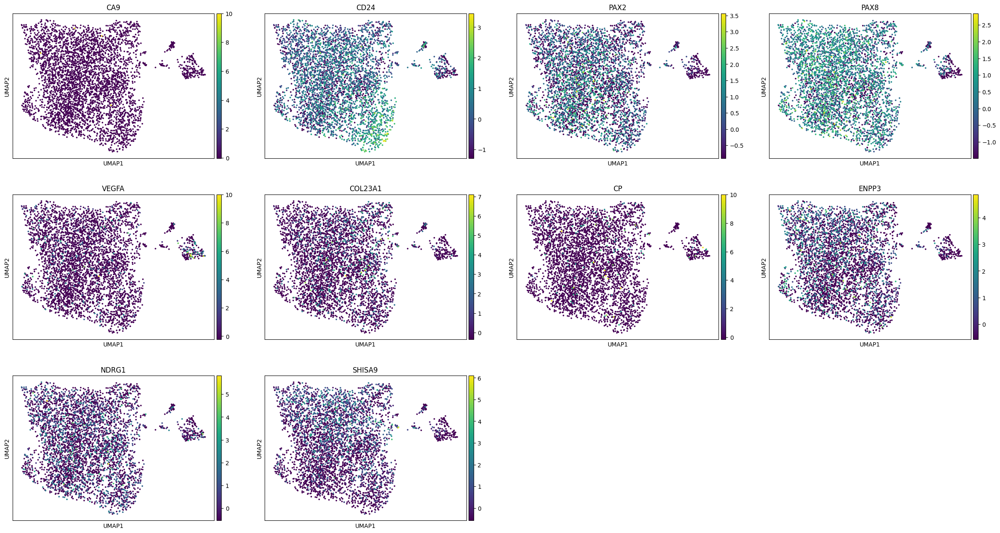

In [221]:
#marker_ccRCC = ["CP","NDRG1","SHISA9"]
marker_ccRCC = ["CA9","CD24","PAX2","PAX8","VEGFA","COL23A1","CP","ENPP3","NDRG1","SHISA9"]
sc.pl.umap(rna, color=marker_ccRCC)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

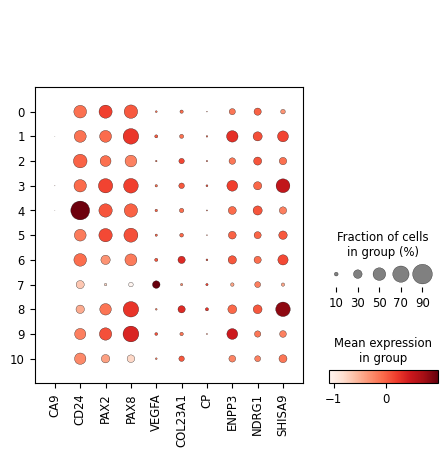

In [222]:
sc.pl.dotplot(rna, marker_ccRCC, groupby="leiden")

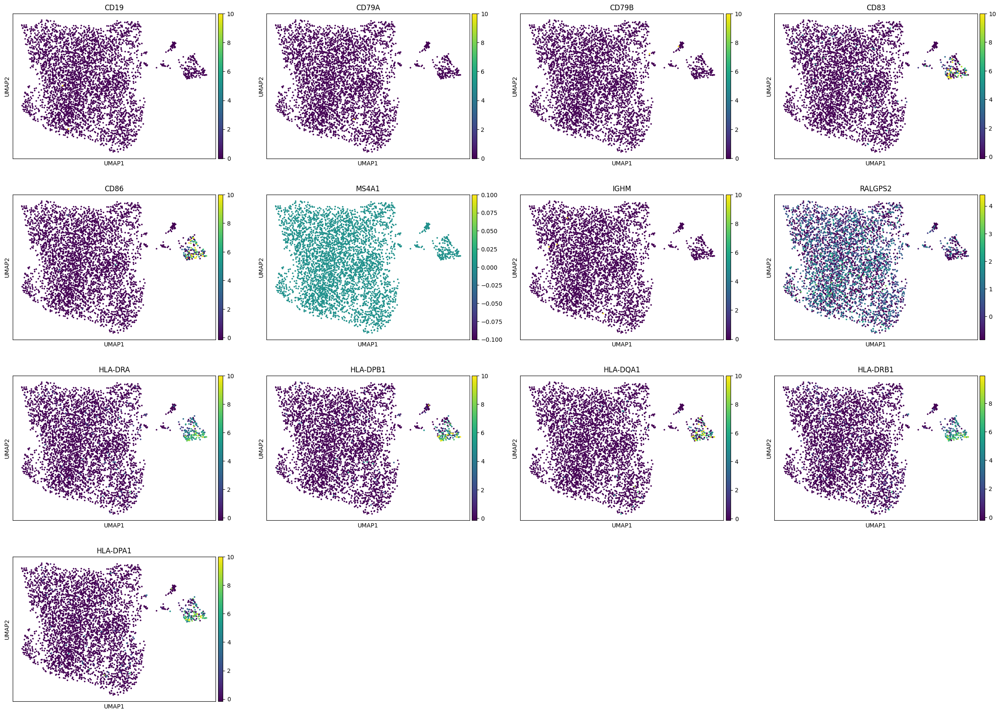

In [223]:
#marker_B_cell= ["CD86", 
                #"HLA-DPB1", "HLA-DQA1", "HLA-DRB1"]
marker_B_cell= ["CD19", "CD79A", "CD79B", "CD83", "CD86", "MS4A1", "IGHM", 
                "RALGPS2", "HLA-DRA", "HLA-DPB1", "HLA-DQA1", "HLA-DRB1", "HLA-DPA1"]
sc.pl.umap(rna, color=marker_B_cell)


/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

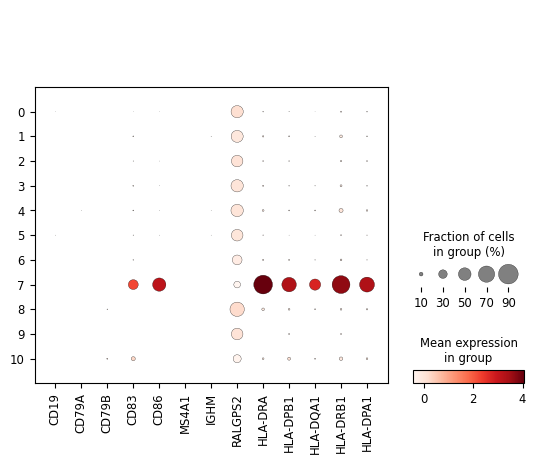

In [224]:
sc.pl.dotplot(rna, marker_B_cell, groupby="leiden")

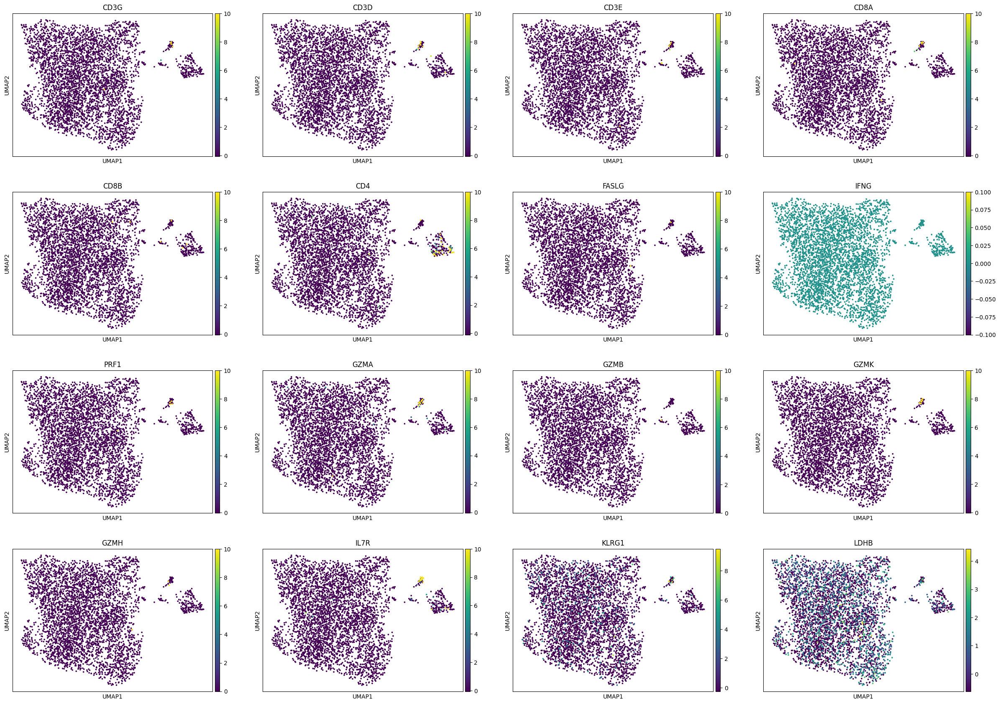

In [225]:
#marker_T_cell = ["CD4",
                 #"IL7R"]
marker_T_cell = ["CD3G","CD3D","CD3E","CD8A","CD8B","CD4","FASLG","IFNG","PRF1",
                 "GZMA","GZMB","GZMK","GZMH","IL7R","KLRG1","LDHB"]
sc.pl.umap(rna, color=marker_T_cell)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

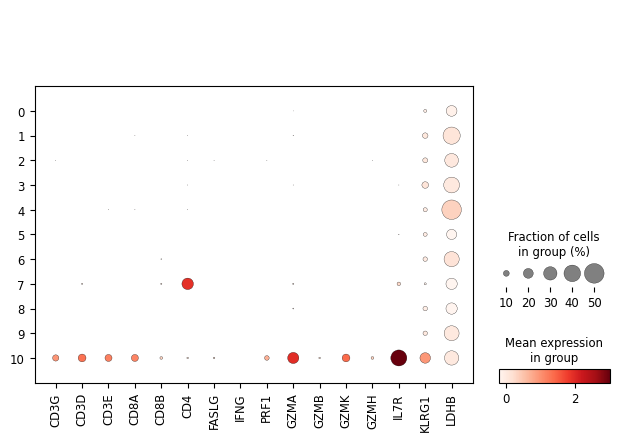

In [226]:
sc.pl.dotplot(rna, marker_T_cell, groupby="leiden")

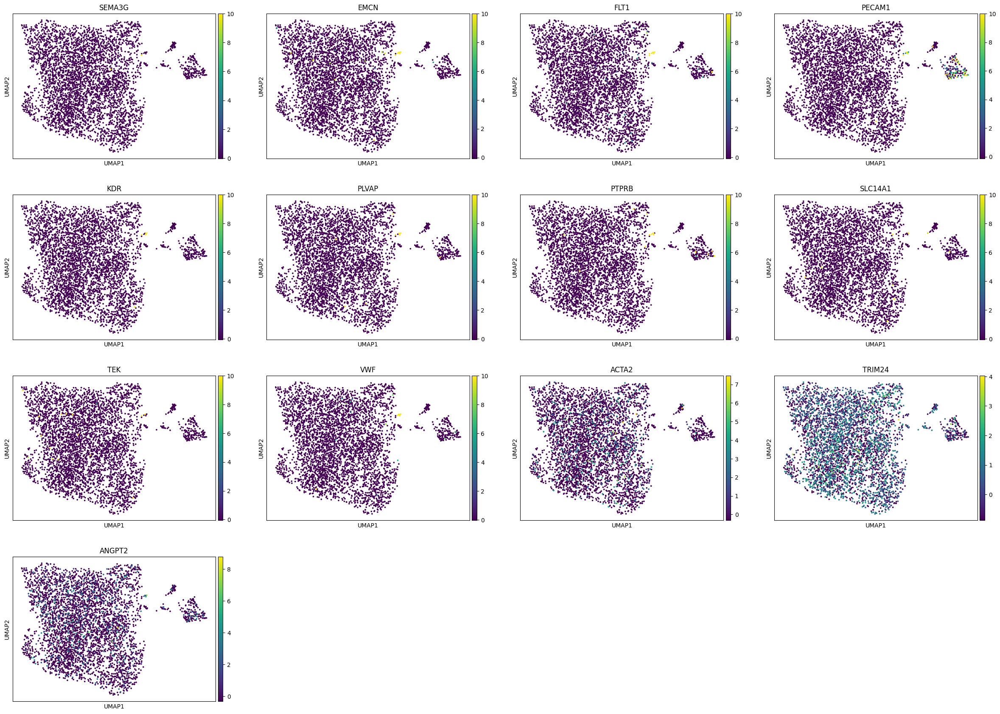

In [227]:
#markers_endothelial=["FLT1","PECAM1","PLVAP","PTPRB","TEK",
#                     "VWF"]
markers_endothelial=["SEMA3G","EMCN","FLT1","PECAM1","KDR","PLVAP","PTPRB","SLC14A1","TEK",
                     "VWF","ACTA2","TRIM24","ANGPT2"]
sc.pl.umap(rna, color=markers_endothelial)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

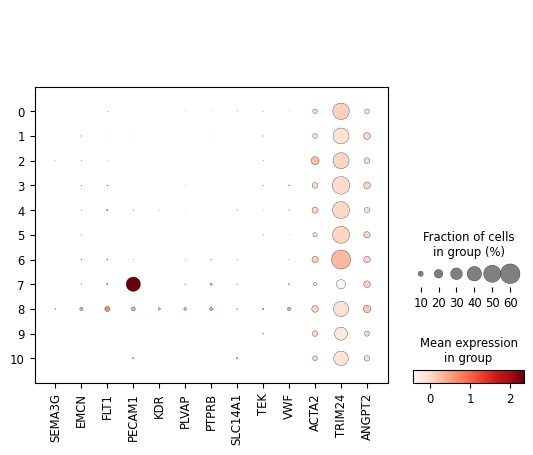

In [228]:
sc.pl.dotplot(rna, markers_endothelial, groupby="leiden")

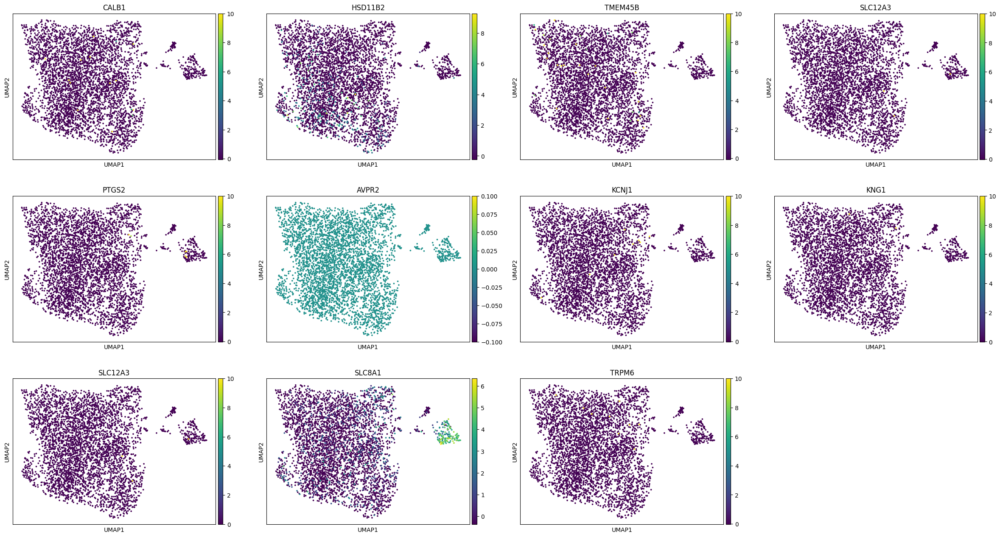

In [229]:
#markers_kidney_tubule= [ 
#                        "KNG1", "SLC8A1"]
markers_kidney_tubule= ["CALB1", "HSD11B2", "TMEM45B", "SLC12A3", "PTGS2", 
                        "AVPR2", "KCNJ1", "KNG1", "SLC12A3", "SLC8A1", "TRPM6"]
sc.pl.umap(rna, color=markers_kidney_tubule)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

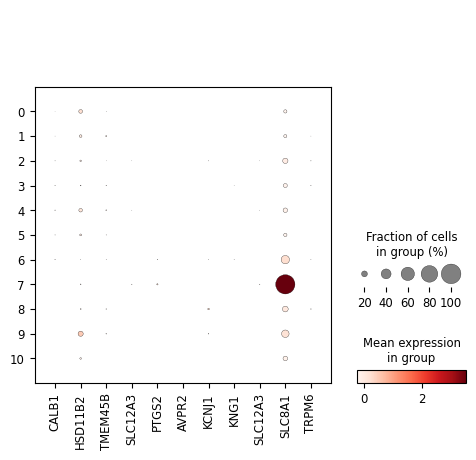

In [230]:
sc.pl.dotplot(rna, markers_kidney_tubule, groupby="leiden")

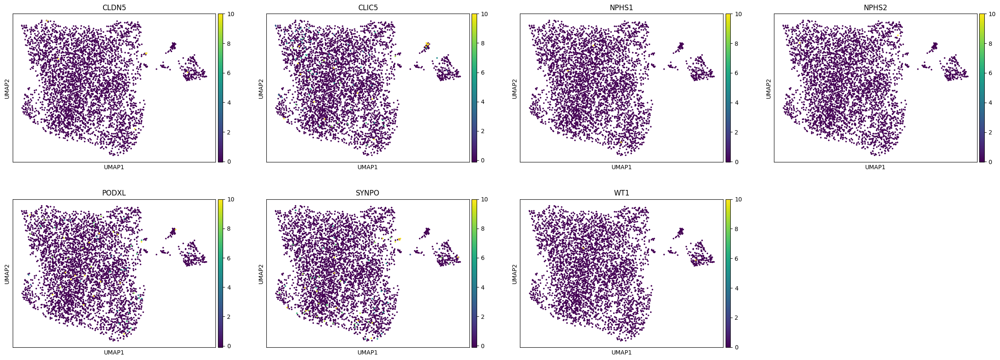

In [231]:
#markers_podocytes= ["WT1"]#No markers found?
markers_podocytes= ["CLDN5", "CLIC5", "NPHS1", "NPHS2", "PODXL", "SYNPO", "WT1"]
sc.pl.umap(rna, color=markers_podocytes)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

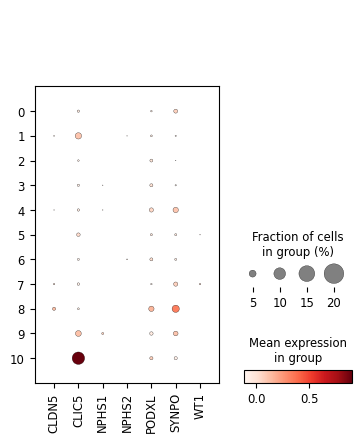

In [232]:
sc.pl.dotplot(rna, markers_podocytes, groupby="leiden")

In [240]:
new_cluster_names = {
    "0": "cancer", "1": "cancer", "2": "cancer", "3": "cancer", "4": "cancer",
    "5": "cancer", "6": "cancer",
    "7": "APC's", "8": "cancer",
    "9":"cancer","10":"T cells",
}
rna.obs['celltype'] = [new_cluster_names[clust] for clust in rna.obs.leiden.astype("str").values.tolist()]


In [241]:
rna.obs['celltype'].value_counts()

celltype
cancer     4002
APC's       155
T cells      55
Name: count, dtype: int64

In [139]:
rna

AnnData object with n_obs × n_vars = 4212 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes', 'leiden', 'celltype'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups', 'celltype_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


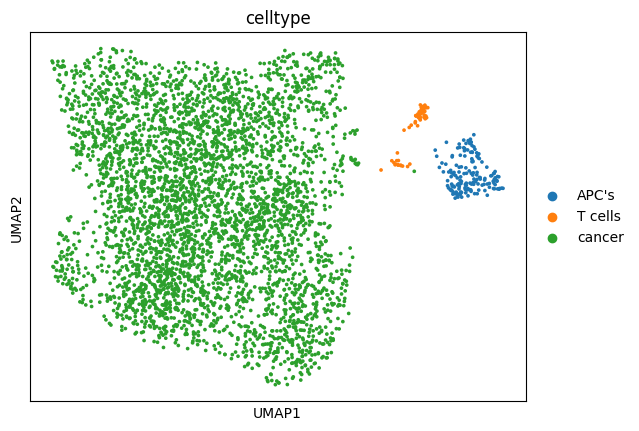

In [242]:
sc.pl.umap(rna, color='celltype')

# Preprocessing of batch 2

In [38]:
rna = mdata_2.mod['rna']
atac = mdata_2.mod['atac']

In [302]:
rna


AnnData object with n_obs × n_vars = 6951 × 36601
    var: 'gene_ids', 'feature_types', 'genome', 'interval'

In [39]:
atac

AnnData object with n_obs × n_vars = 6951 × 67150
    var: 'gene_ids', 'feature_types', 'genome', 'interval'

In [303]:
rna.var_names_make_unique()

In [304]:
rna.var['mt'] = rna.var_names.str.startswith('MT-')

In [305]:
sc.pp.calculate_qc_metrics(
    rna, qc_vars=['mt'], inplace=True, percent_top=[20],log1p=True
)

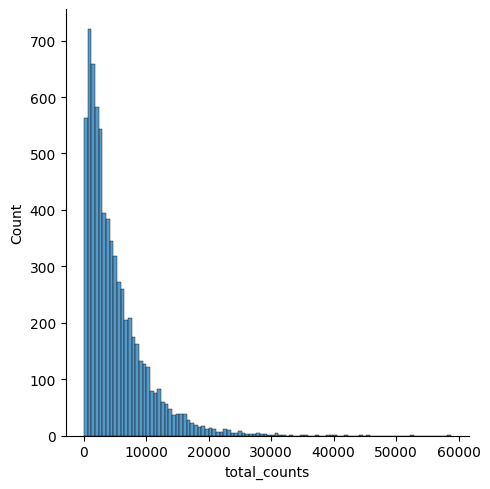

In [ ]:
p1 = sns.displot(rna.obs["total_counts"], bins=100, kde=False)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


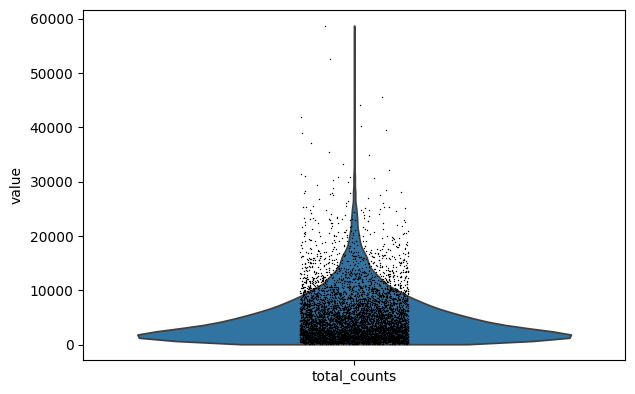

In [ ]:
p8 = sc.pl.violin(rna, 'total_counts')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


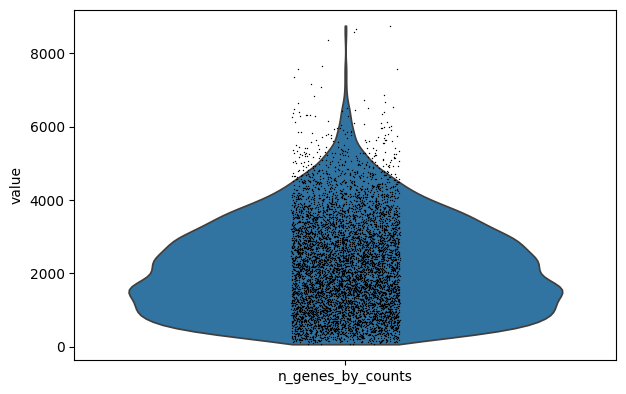

In [ ]:
p9 = sc.pl.violin(rna, 'n_genes_by_counts')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_anndata.py:839: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


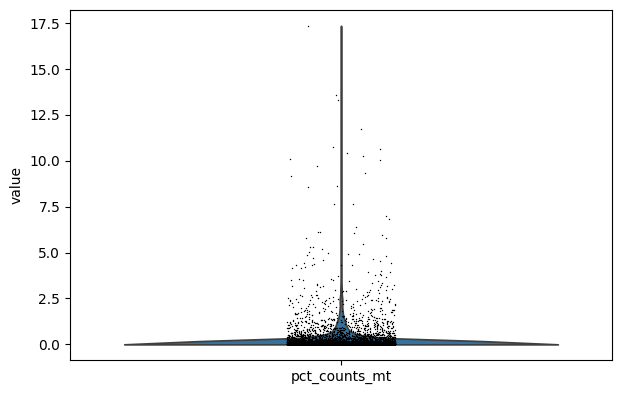

In [ ]:
p9 = sc.pl.violin(rna, 'pct_counts_mt')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_utils.py:716: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  color = color[sort]


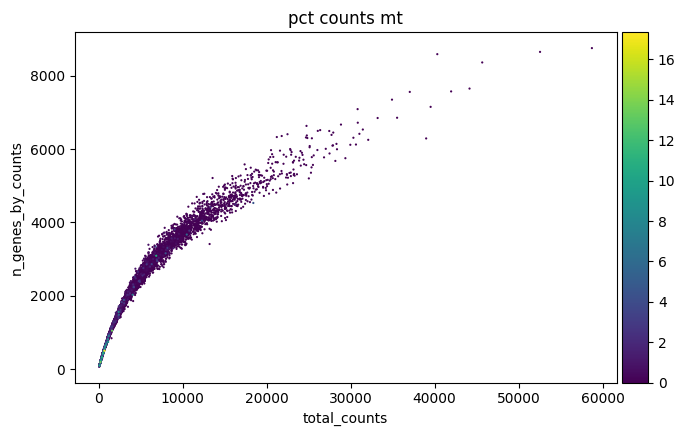

In [ ]:
p3 = sc.pl.scatter(rna, "total_counts", "n_genes_by_counts", color="pct_counts_mt",size=10)

In [306]:
sc.pp.filter_cells(rna, min_genes=300)
sc.pp.filter_cells(rna, max_genes=7000)

In [307]:
rna

AnnData object with n_obs × n_vars = 6753 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [308]:
rna = rna[rna.obs['total_counts'] >= 500, :]
rna = rna[rna.obs['total_counts'] <= 25000, :]

In [309]:
rna

View of AnnData object with n_obs × n_vars = 6555 × 36601
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'

In [310]:
rna = rna[rna.obs['pct_counts_mt'] < 10, :]

In [311]:
sc.pp.normalize_total(rna)
sc.pp.log1p(rna)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [312]:
sc.pp.highly_variable_genes(rna, n_top_genes=2000)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


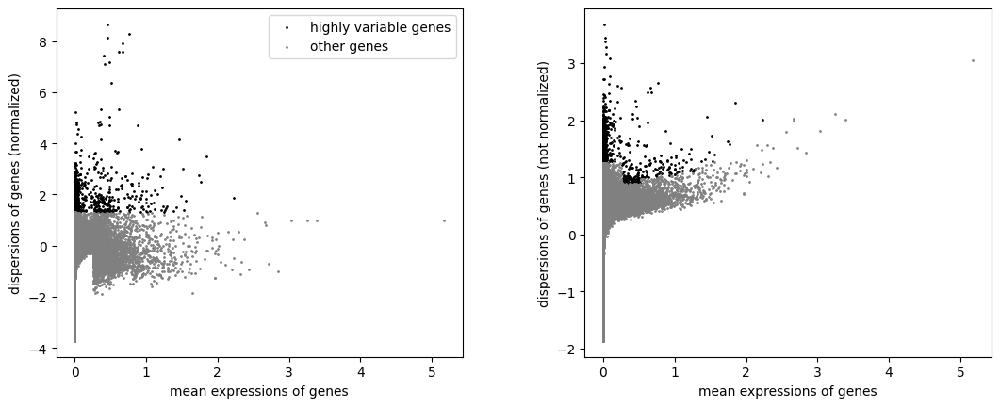

In [313]:
sc.pl.highly_variable_genes(rna)

In [ ]:
#rna = rna[:, rna.var.highly_variable]

In [ ]:
rna

View of AnnData object with n_obs × n_vars = 6549 × 2000
    obs: 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'n_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'hvg'

In [314]:
sc.pp.scale(rna,max_value=10)

In [315]:
sc.tl.pca(rna)

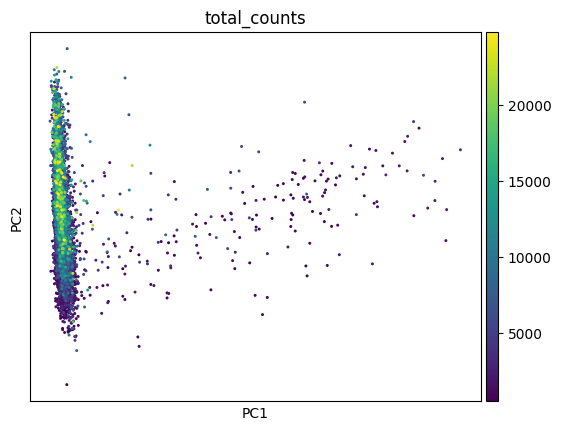

In [317]:
sc.pl.pca(rna, color="total_counts")

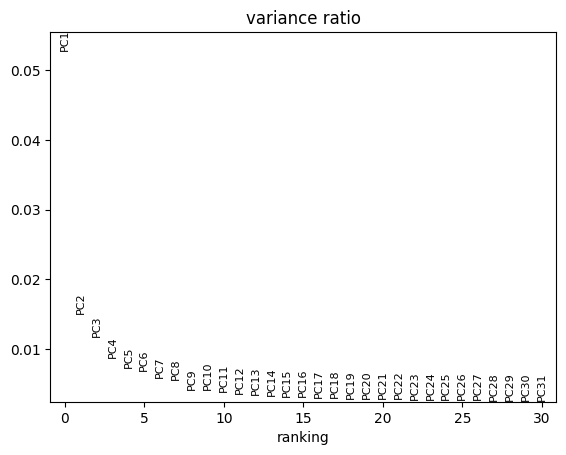

In [318]:
sc.pl.pca_variance_ratio(rna)

In [319]:
sc.pp.neighbors(rna,n_pcs=15)

In [320]:
sc.tl.umap(rna)

In [321]:
sc.tl.leiden(rna, resolution=0.8)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


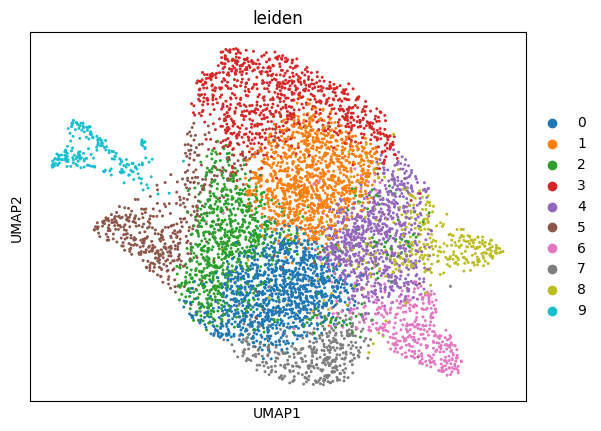

In [322]:
sc.pl.umap(rna, color='leiden')

In [40]:
sc.pp.calculate_qc_metrics(atac, percent_top=None, log1p=False, inplace=True)

In [41]:
atac

AnnData object with n_obs × n_vars = 6951 × 67150
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

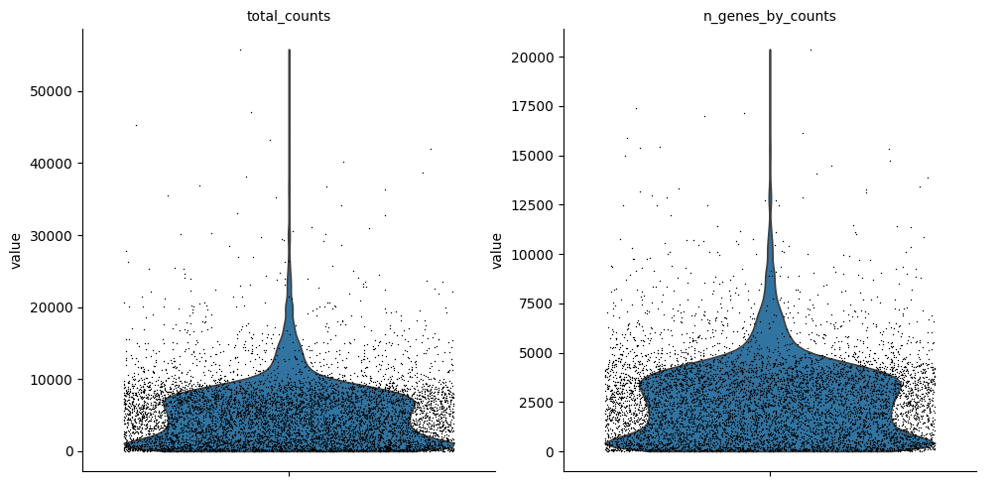

In [ ]:
sc.pl.violin(atac, ['total_counts', 'n_genes_by_counts'], jitter=0.4, multi_panel=True)

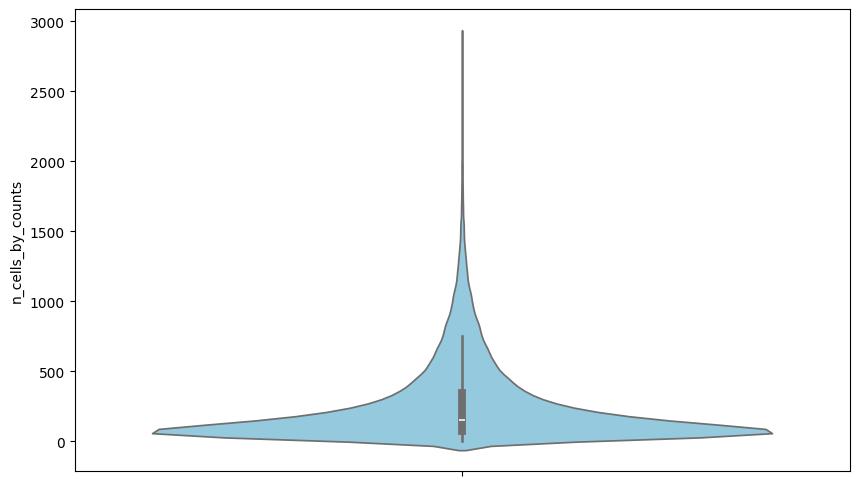

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.violinplot(data=atac.var['n_cells_by_counts'],color='skyblue')
plt.show()

In [42]:
mu.pp.filter_var(atac, 'n_cells_by_counts', lambda x: x >= 20)
mu.pp.filter_var(atac, 'n_cells_by_counts', lambda x: x <= 1500)

In [43]:
atac

AnnData object with n_obs × n_vars = 6951 × 64774
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [44]:

mu.pp.filter_obs(atac, 'n_genes_by_counts', lambda x: (x >= 200) & (x <= 10000))


In [45]:
mu.pp.filter_obs(atac, 'total_counts', lambda x: (x >= 500) & (x <= 20000))

In [46]:
atac

AnnData object with n_obs × n_vars = 6092 × 64774
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [ ]:

atac.layers['counts'] = atac.X

In [ ]:

sc.pp.normalize_per_cell(atac, counts_per_cell_after=1e4)
sc.pp.log1p(atac)

In [ ]:
sc.pp.highly_variable_genes(atac, min_mean=0.05, max_mean=1.5, min_disp=.5)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:226: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby("mean_bin")["dispersions"]


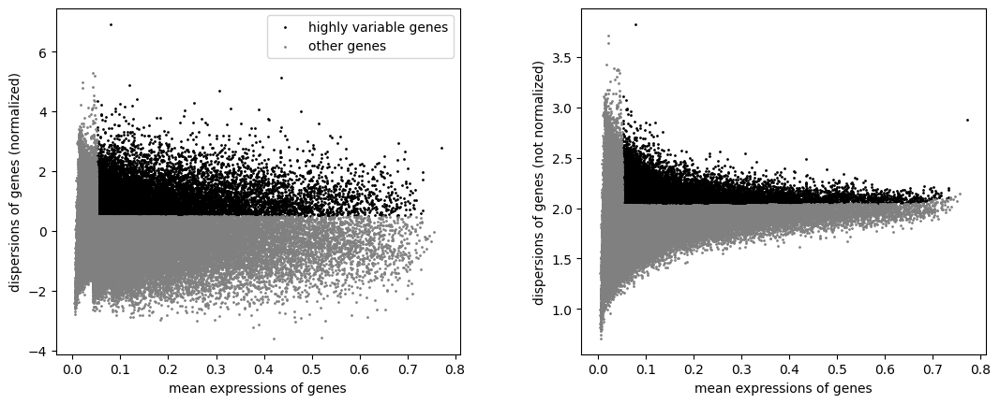

In [ ]:
sc.pl.highly_variable_genes(atac)

In [ ]:
np.sum(atac.var.highly_variable)

13375

In [ ]:
atac.raw = atac

In [ ]:
ac.tl.lsi(atac)

In [47]:
atac

AnnData object with n_obs × n_vars = 6092 × 64774
    obs: 'n_genes_by_counts', 'total_counts'
    var: 'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'

In [ ]:
atac.obsm['X_lsi'] = atac.obsm['X_lsi'][:,1:]
atac.varm["LSI"] = atac.varm["LSI"][:,1:]
atac.uns["lsi"]["stdev"] = atac.uns["lsi"]["stdev"][1:]

In [ ]:
sc.pp.neighbors(atac, use_rep="X_lsi", n_neighbors=10, n_pcs=30)

In [ ]:
sc.pp.scale(atac)
sc.tl.pca(atac)

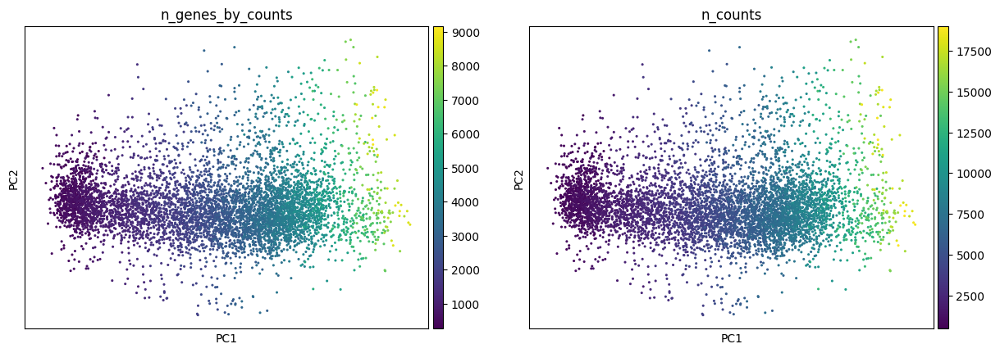

In [ ]:
sc.pl.pca(atac, color=["n_genes_by_counts", "n_counts"])

In [ ]:
sc.pp.neighbors(atac, n_neighbors=10, n_pcs=30)

In [ ]:

sc.tl.leiden(atac, resolution=.5)

In [ ]:
sc.tl.umap(atac, spread=1.5, min_dist=.5, random_state=20)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


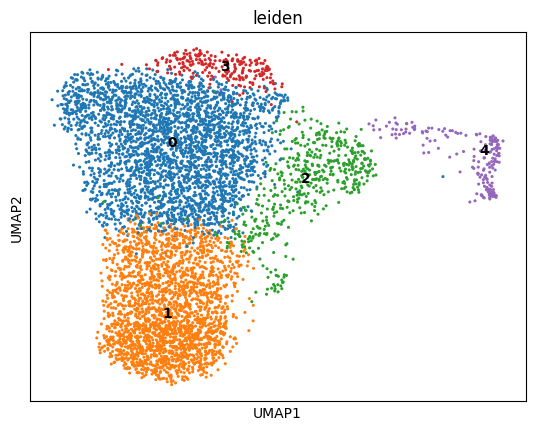

In [ ]:
sc.pl.umap(atac, color="leiden", legend_loc="on data")

In [48]:
mdata_2.mod['rna'] = rna
mdata_2.mod['atac'] = atac

In [49]:
mdata_2 = mdata_2.copy()

/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1531: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("var", axis=0, join_common=join_common)
/vol/storage/shared/miniforge3/envs/ssb/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("obs", axis=1, join_common=join_common)


In [ ]:
mu.pp.intersect_obs(mdata_2)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/mudata/_core/mudata.py:1429: FutureWarning: From 0.4 .update() will not pull obs/var columns from individual modalities by default anymore. Set mudata.set_options(pull_on_update=False) to adopt the new behaviour, which will become the default. Use new pull_obs/pull_var and push_obs/push_var methods for more flexibility.
  self._update_attr("obs", axis=1, join_common=join_common)


## Tsv for rna

In [ ]:
barcodes = mdata_2.mod['rna'].obs.index
gene_ids = mdata_2.mod['rna'].var['gene_ids']

In [ ]:

expression_matrix = mdata_2.mod['rna'].X
if not isinstance(expression_matrix, np.ndarray):
    expression_matrix = expression_matrix.toarray() 

In [ ]:
data_2 = pd.DataFrame(
    {
        'barcode': np.repeat(barcodes, len(gene_ids)),
        'gene_id': np.tile(gene_ids, len(barcodes)),
        'expression_count': expression_matrix.flatten()
    }
)

In [ ]:
data1 = data_2[data_2['expression_count'] != 0]

In [ ]:
data1['expression_count'].mean()

1.0242797

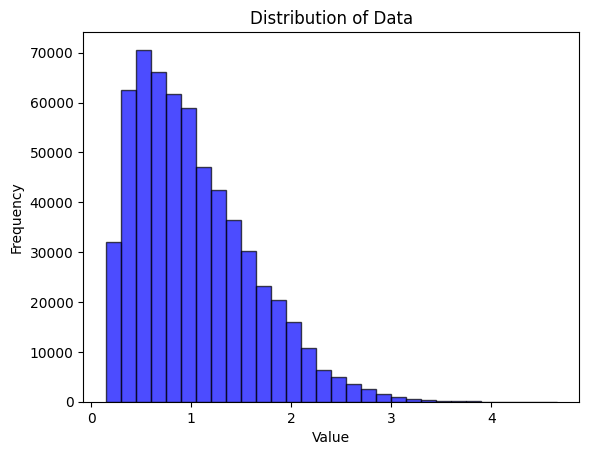

In [ ]:
plt.hist(data1['expression_count'], bins=30, color='blue', alpha=0.7, edgecolor='black')
plt.title('Distribution of Data')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.show()

In [ ]:
median_expression = data1['expression_count'].median()

In [ ]:

data_2['classification'] = data_2['expression_count'].apply(
    lambda x: 'high' if x > median_expression  
            else 'zero' if x == 0 
            else 'low'
)

In [ ]:
classification_counts_median = data_2['classification'].value_counts()

In [ ]:
classification_counts_median

classification
zero    10846257
low       299971
high      299772
Name: count, dtype: int64

In [ ]:
data_2

,barcode,gene_id,expression_count,classification
0,AAACAGCCAAACGCGA-2,ENSG00000229905,0.0,zero
1,AAACAGCCAAACGCGA-2,ENSG00000187583,0.0,zero
2,AAACAGCCAAACGCGA-2,ENSG00000169972,0.0,zero
3,AAACAGCCAAACGCGA-2,ENSG00000231050,0.0,zero
4,AAACAGCCAAACGCGA-2,ENSG00000233542,0.0,zero
...,...,...,...,...
11445995,TTTGTTGGTTAGCTGA-2,ENSG00000212907,0.0,zero
11445996,TTTGTTGGTTAGCTGA-2,ENSG00000198886,0.0,zero
11445997,TTTGTTGGTTAGCTGA-2,ENSG00000198786,0.0,zero
11445998,TTTGTTGGTTAGCTGA-2,ENSG00000198727,0.0,zero


In [ ]:
#data_1.to_csv('/Users/isabelgiray/Desktop/classification_median_batch_1.tsv', sep='\t', index=False)
#data_2.to_csv('/Users/isabelgiray/Desktop/classification_median_batch_2.tsv', sep='\t', index=False)


## Create a tsv file for atac

In [50]:
barcodes = mdata_2.mod['atac'].obs.index
peak_region = mdata_2.mod['atac'].var['gene_ids']

In [51]:
open_matrix = mdata_2.mod['atac'].X
if not isinstance(open_matrix, np.ndarray):
    open_matrix = open_matrix.toarray()

In [52]:
open_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [53]:
import numpy as np

# Count nonzero elements
num_nonzero = np.count_nonzero(open_matrix)

# Count negative elements
num_negative = np.sum(open_matrix < 0)

print(f"Nonzero elements: {num_nonzero}")
print(f"Negative elements: {num_negative}")


Nonzero elements: 15951195
Negative elements: 0


In [54]:
data_2 = pd.DataFrame(
    {
        'barcode': np.repeat(barcodes, len(peak_region)),
        'peak region': np.tile(peak_region, len(barcodes)),
        'opennes': open_matrix.flatten()
    }
)

In [55]:
data_2.head()

,barcode,peak region,opennes
0,AAACAGCCAAACGCGA-2,chr1:9855-10676,0.0
1,AAACAGCCAAACGCGA-2,chr1:181027-181582,0.0
2,AAACAGCCAAACGCGA-2,chr1:629494-630387,0.0
3,AAACAGCCAAACGCGA-2,chr1:633523-634601,0.0
4,AAACAGCCAAACGCGA-2,chr1:778319-779215,0.0


In [ ]:
data_2.to_csv("../data/splits/atac_batch2.tsv", sep='\t', index=False)


: 

# Annotation for Batch 2

In [ ]:
rna = mdata_2.mod['rna']

In [323]:
sc.tl.rank_genes_groups(rna, 'leiden', method='t-test')

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:422: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/tools/_rank_genes

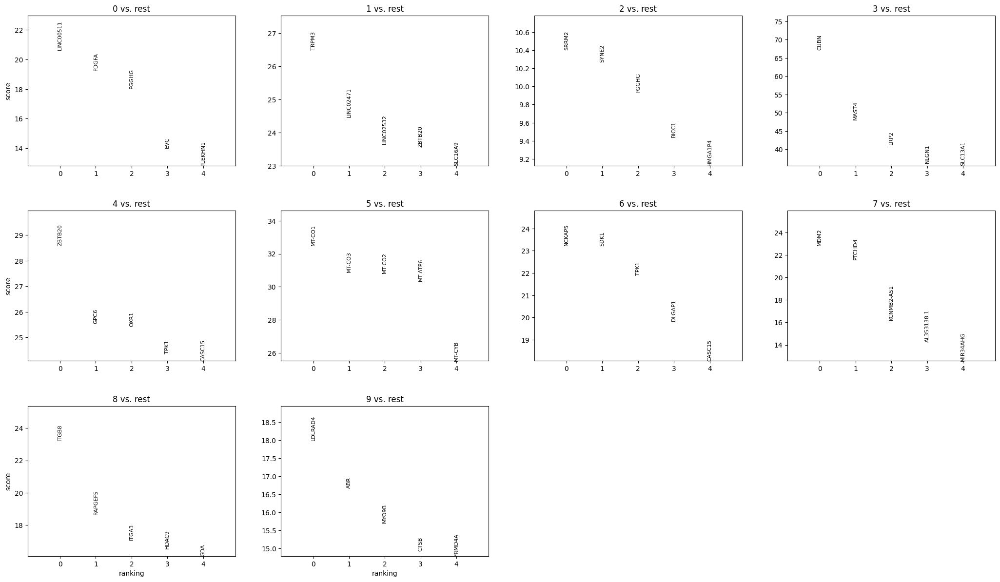

In [325]:
sc.pl.rank_genes_groups(rna, n_genes=5, sharey=False)

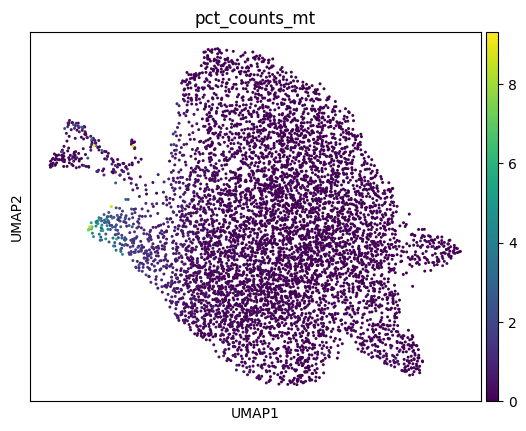

In [171]:
sc.pl.umap(rna, color='pct_counts_mt')

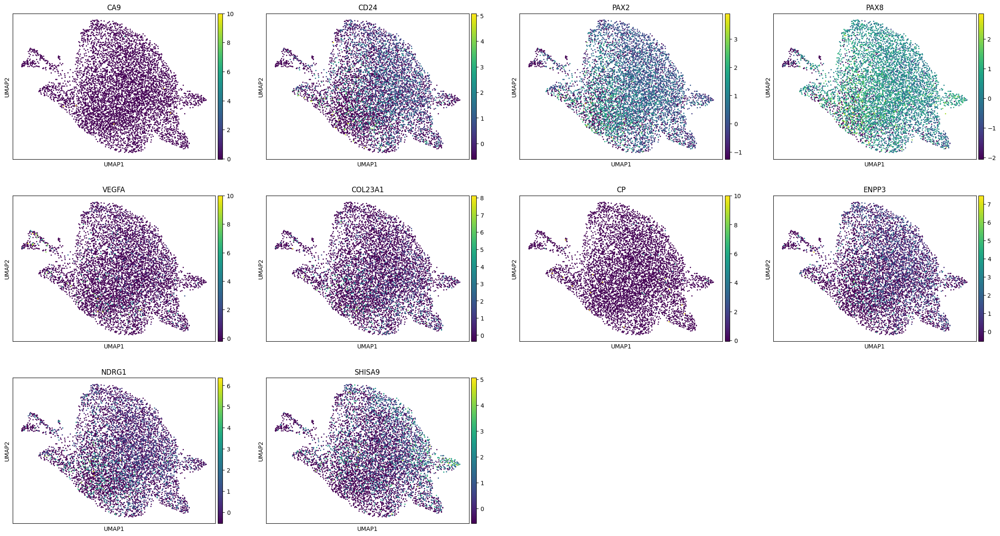

In [326]:
marker_ccRCC = ["CA9","CD24","PAX2","PAX8","VEGFA","COL23A1","CP","ENPP3","NDRG1","SHISA9"]
sc.pl.umap(rna, color=marker_ccRCC)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

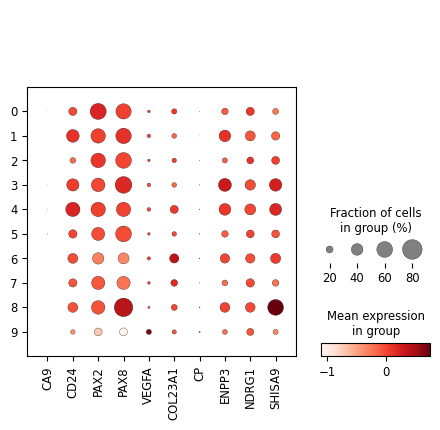

In [327]:
sc.pl.dotplot(rna, marker_ccRCC, groupby="leiden")

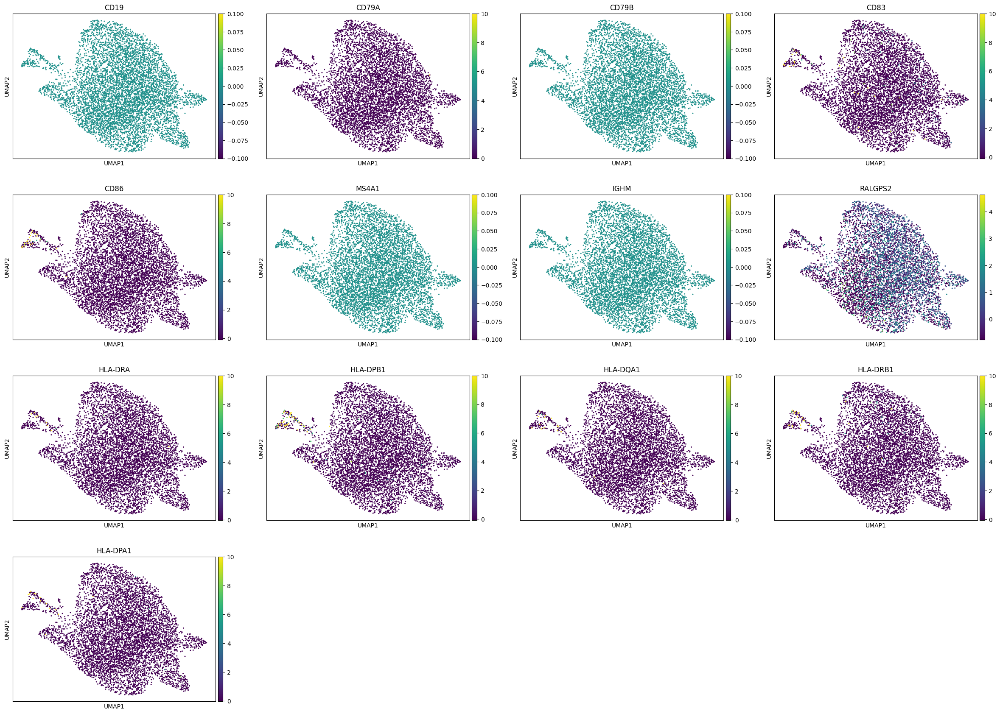

In [328]:
marker_B_cell= ["CD19", "CD79A", "CD79B", "CD83", "CD86", "MS4A1", "IGHM", 
                "RALGPS2", "HLA-DRA", "HLA-DPB1", "HLA-DQA1", "HLA-DRB1", "HLA-DPA1"]
sc.pl.umap(rna, color=marker_B_cell)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

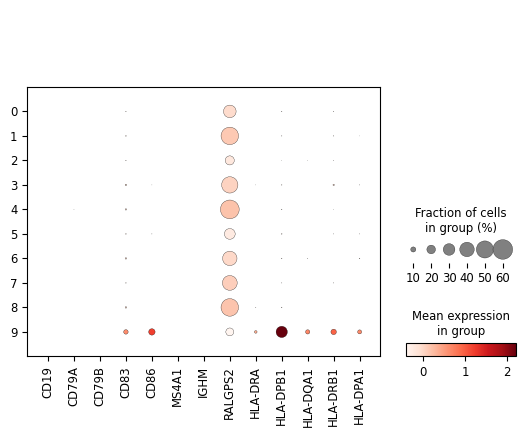

In [329]:
sc.pl.dotplot(rna, marker_B_cell, groupby="leiden")

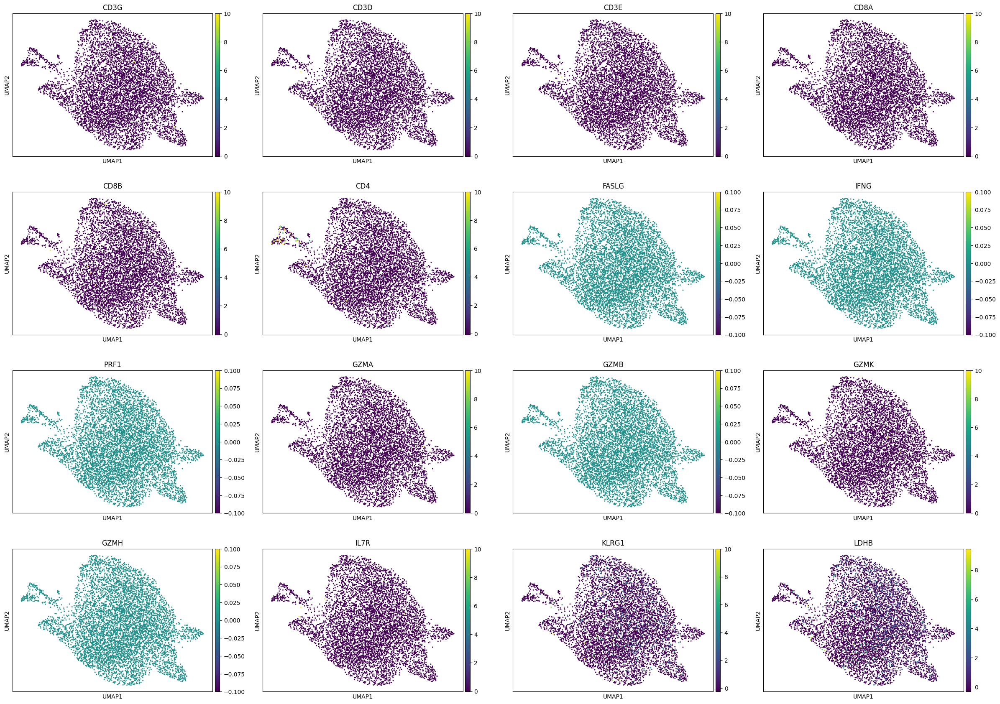

In [330]:
marker_T_cell = ["CD3G","CD3D","CD3E","CD8A","CD8B","CD4","FASLG","IFNG","PRF1",
                 "GZMA","GZMB","GZMK","GZMH","IL7R","KLRG1","LDHB"]
sc.pl.umap(rna, color=marker_T_cell)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

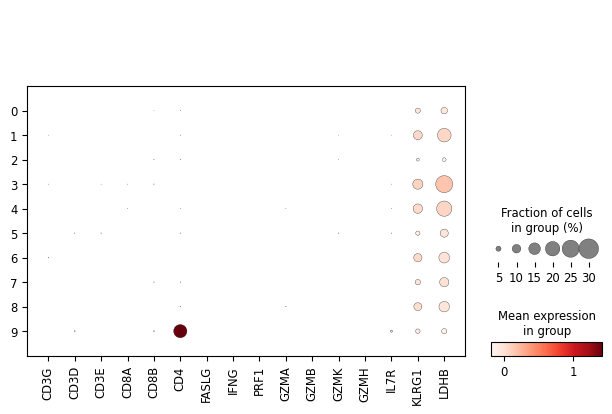

In [331]:
sc.pl.dotplot(rna, marker_T_cell, groupby="leiden")

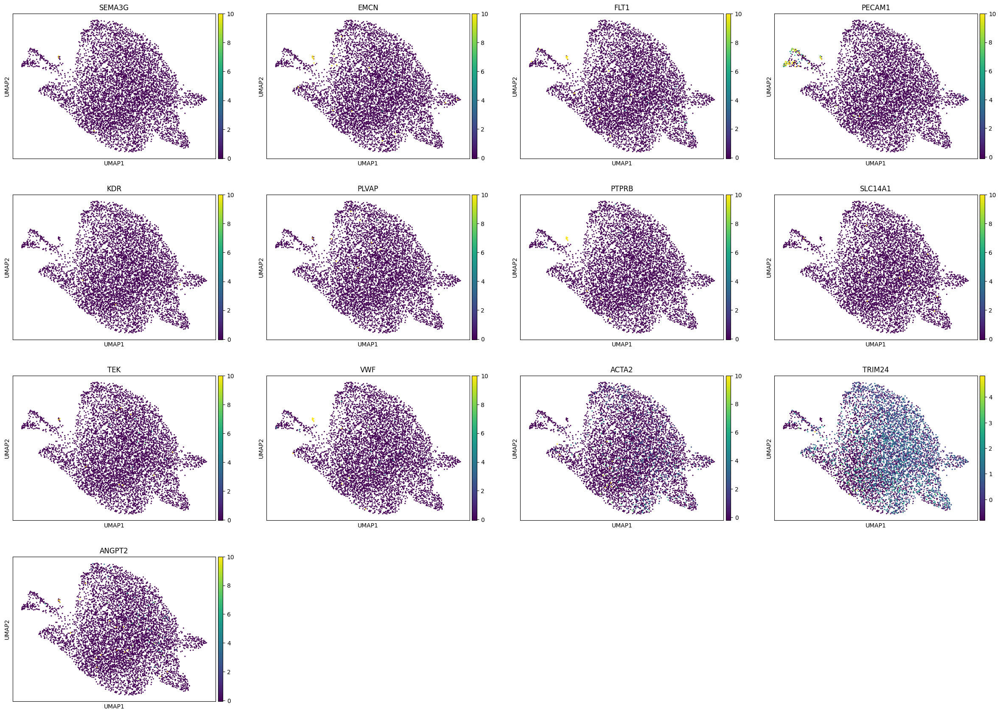

In [332]:
markers_endothelial=["SEMA3G","EMCN","FLT1","PECAM1","KDR","PLVAP","PTPRB","SLC14A1","TEK",
                     "VWF","ACTA2","TRIM24","ANGPT2"]
sc.pl.umap(rna, color=markers_endothelial)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

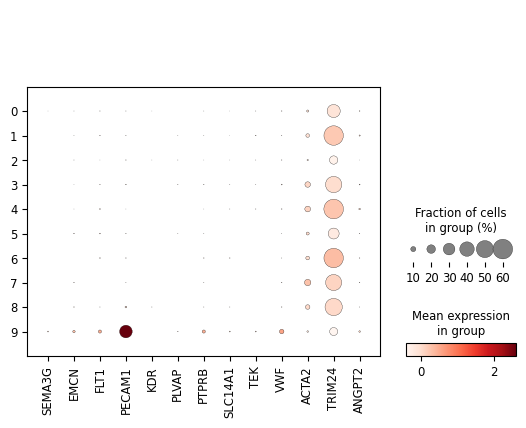

In [333]:
sc.pl.dotplot(rna, markers_endothelial, groupby="leiden")

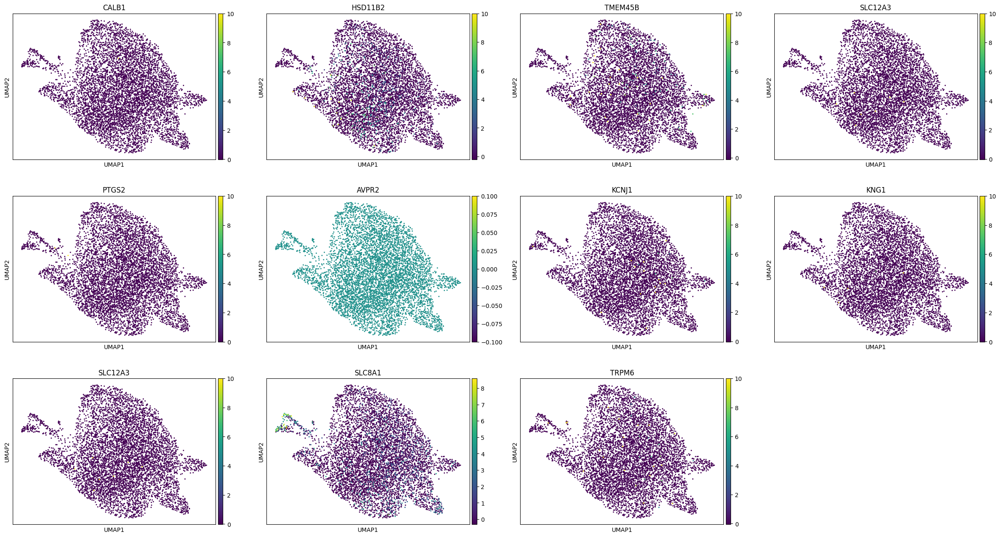

In [334]:
markers_kidney_tubule= ["CALB1", "HSD11B2", "TMEM45B", "SLC12A3", "PTGS2", 
                        "AVPR2", "KCNJ1", "KNG1", "SLC12A3", "SLC8A1", "TRPM6"]
sc.pl.umap(rna, color=markers_kidney_tubule)

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:168: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  obs_bool.groupby(level=0).sum() / obs_bool.groupby(level=0).count()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:178: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dot_color_df = self.obs_tidy.groupby(level=0).mean()
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_dotplot.py:747: UserWarning: No data for colormapping provided via 'c'. Paramete

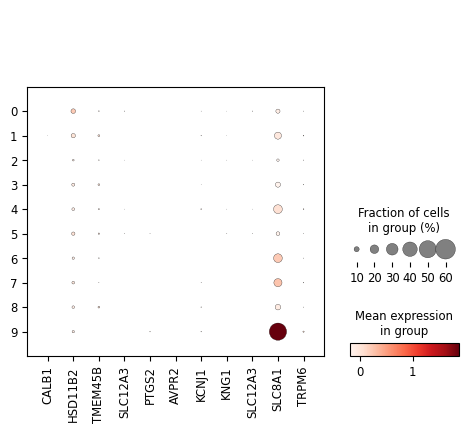

In [335]:
sc.pl.dotplot(rna, markers_kidney_tubule, groupby="leiden")


In [336]:
#Rename clusters:
new_cluster_names = {
    "0": "cancer", "1": "cancer", "2": "cancer", "3": "cancer", "4": "cancer",
    "5": "cancer", "6": "cancer",
    "7": "cancer", "8": "cancer",
    "9":"healthy"}


rna.obs['celltype'] = [new_cluster_names[clust] for clust in rna.obs.leiden.astype("str").values.tolist()]

In [337]:
rna.obs['celltype'].value_counts()

celltype
cancer     6357
healthy     192
Name: count, dtype: int64

/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Library/Frameworks/Python.framework/Versions/3.12/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


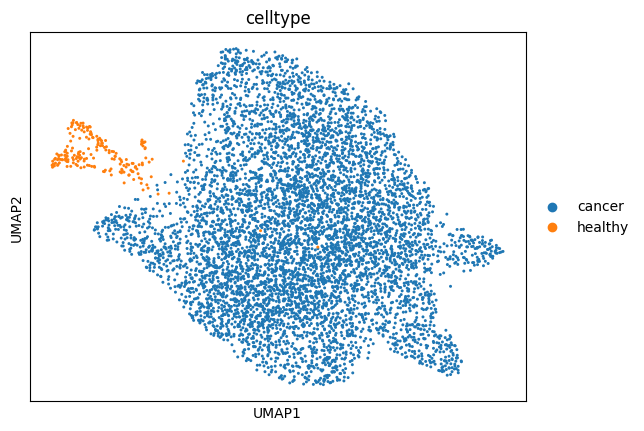

In [338]:
sc.pl.umap(rna, color='celltype')

In [341]:
barcodes = rna.obs.index
clustering = rna.obs['leiden']
celltype = rna.obs['celltype']

In [343]:
data_batch_2 = pd.DataFrame({
    'barcodes': barcodes,
    'leiden': clustering,
    'celltype': celltype
}).reset_index(drop=True)

In [344]:
data_batch_2

,barcodes,leiden,celltype
0,AAACAGCCAAACGCGA-2,4,cancer
1,AAACAGCCAGTAAGTA-2,2,cancer
2,AAACAGCCATCGTTCT-2,4,cancer
3,AAACATGCACCAACCG-2,6,cancer
4,AAACATGCAGGAACCA-2,4,cancer
...,...,...,...
6544,TTTGTTGGTATTGCAG-2,6,cancer
6545,TTTGTTGGTCTTGCAT-2,7,cancer
6546,TTTGTTGGTGAGCAAG-2,3,cancer
6547,TTTGTTGGTTAAGTGT-2,8,cancer


In [345]:
data_batch_2.to_csv("/Users/isabelgiray/Desktop/batch_2_clustering.tsv", sep="\t", index=False)